# Analysis of selected word senses in LatinISE corpus

In [ ]:
import pandas as pd

latinise = pd.read_csv("latinise_predictions_with_senses.csv", index_col = 0)

In [ ]:
latinise

,lemma,accuracy,sentence,sense,epoch
0,deduco,0,non tristitia deducit,1,0
1,deduco,0,sine priu deduci,1,0
2,deduco,0,deducere in omnem veritatem,1,0
3,deduco,0,deducere in omnem veritatem,1,0
4,deduco,1,deducunt litore puppes,0,0
...,...,...,...,...,...
702340,fere,0,et quia longe commodius est possidere potius q...,1,0
702341,fere,1,ex quibus fere una illa legitimam causam habet...,0,0
702342,fere,0,"et quia , sive cum servis negotium gestum sit ...",1,0
702343,fere,1,"nam cum prudentibus ambiguum fuerat , utrum do...",0,0


## General Word Sense Histogram

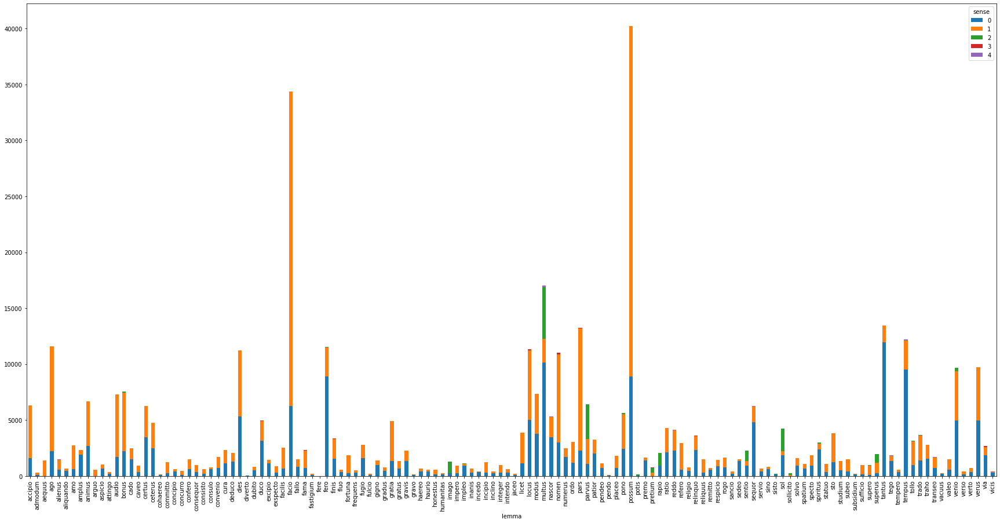

In [ ]:
latinise.groupby(["lemma", "sense"]).size().unstack().plot(kind='bar', stacked=True, figsize=(30, 15))

# Lemma's list

In [ ]:
import pandas as pd

latinise = pd.read_csv("latinise_predictions_with_senses.csv")

In [ ]:
latinise.lemma.unique()

array(['deduco', 'fero', 'possum', 'certus', 'sol', 'tantus', 'tollo',
       'nascor', 'ceterus', 'traho', 'ago', 'pars', 'rapio', 'gratia',
       'fama', 'facio', 'specto', 'fallo', 'amplus', 'respicio', 'tempus',
       'nomen', 'patior', 'sequor', 'integer', 'premo', 'pendeo', 'sto',
       'trado', 'subeo', 'tego', 'gratus', 'parvus', 'gravis', 'locus',
       'reddo', 'duco', 'licet', 'spatium', 'ordo', 'imago', 'haurio',
       'gigno', 'multus', 'finis', 'audio', 'facilis', 'numerus', 'fugio',
       'accipio', 'ratio', 'animus', 'dies', 'superus', 'amo', 'sentio',
       'via', 'pono', 'aequus', 'cado', 'inanis', 'committo', 'fastigium',
       'excipio', 'relinquo', 'statuo', 'supero', 'venio', 'confero',
       'exspecto', 'refero', 'tempero', 'incipio', 'solvo', 'attingo',
       'fulcio', 'modus', 'alienus', 'sedeo', 'cura', 'haereo', 'rogo',
       'aspicio', 'cohaereo', 'placeo', 'verso', 'verus', 'fortuna',
       'bonus', 'transeo', 'valeo', 'sino', 'dubito', 'arguo',

## Visualise individual lemmas by date (with automatically extracted english sense in legend)

In [ ]:
import matplotlib.pyplot as plt
import os

<ipython-input-143-1529768ca226>:6: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  latinise.dropna()[latinise.lemma==lemma].sort_values("date").groupby(["period", "sense"], sort=False).size().unstack().plot(figsize=(20, 10))
<ipython-input-143-1529768ca226>:10: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  for x in latinise.dropna()[latinise.lemma==lemma].groupby(["sense"])["sense_filtered"].last():
<ipython-input-143-1529768ca226>:6: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  latinise.dropna()[latinise.lemma==lemma].sort_values("date").groupby(["period", "sense"], sort=False).size().unstack().plot(figsize=(20, 10))
<ipython-input-143-1529768ca226>:10: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  for x in latinise.dropna()[latinise.lemma==lemma].groupby(["sense"])["sense_filtered"].last():
<ipython-input-143-1529768ca226>:6: UserWarning: Boolean Series key 

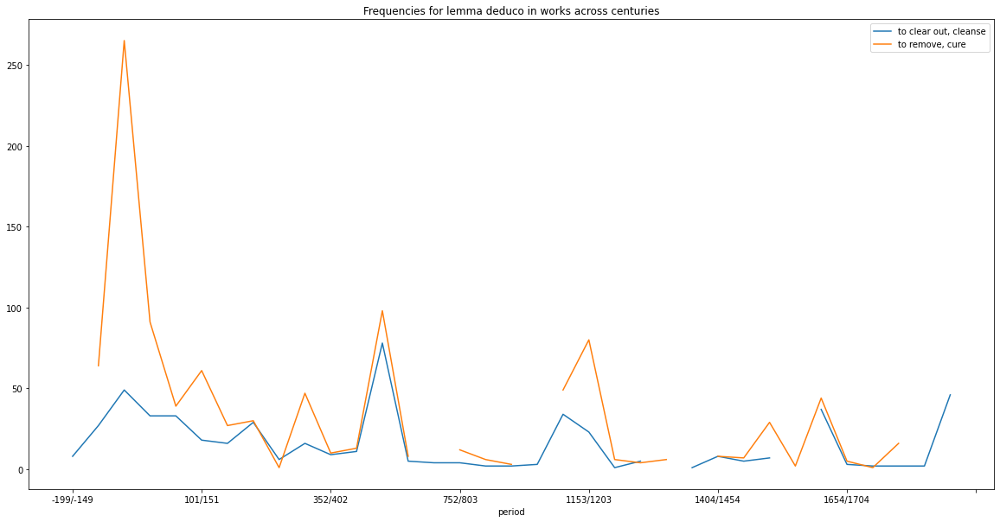

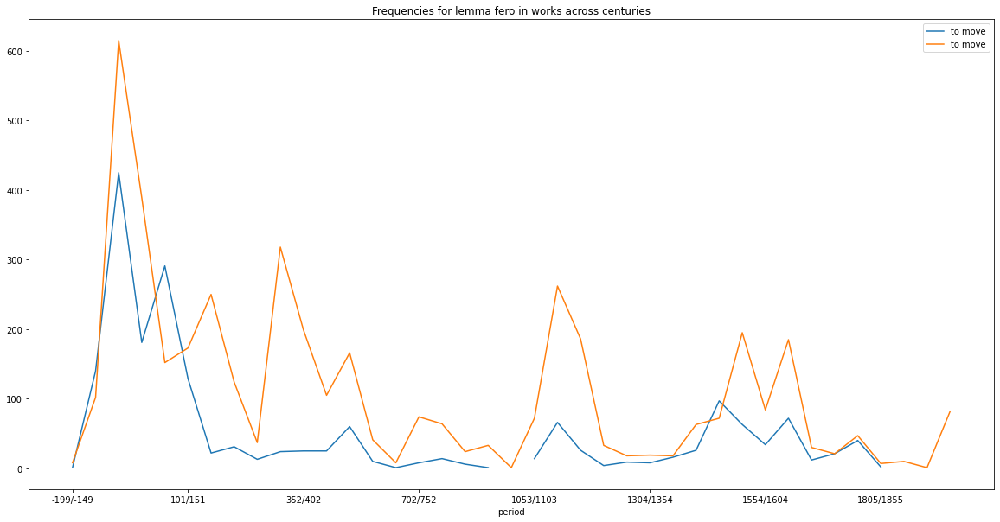

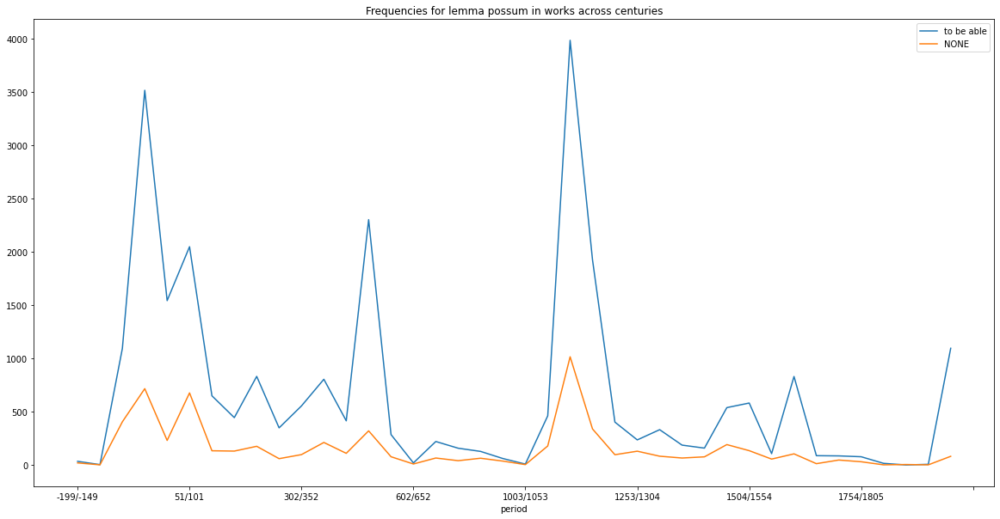

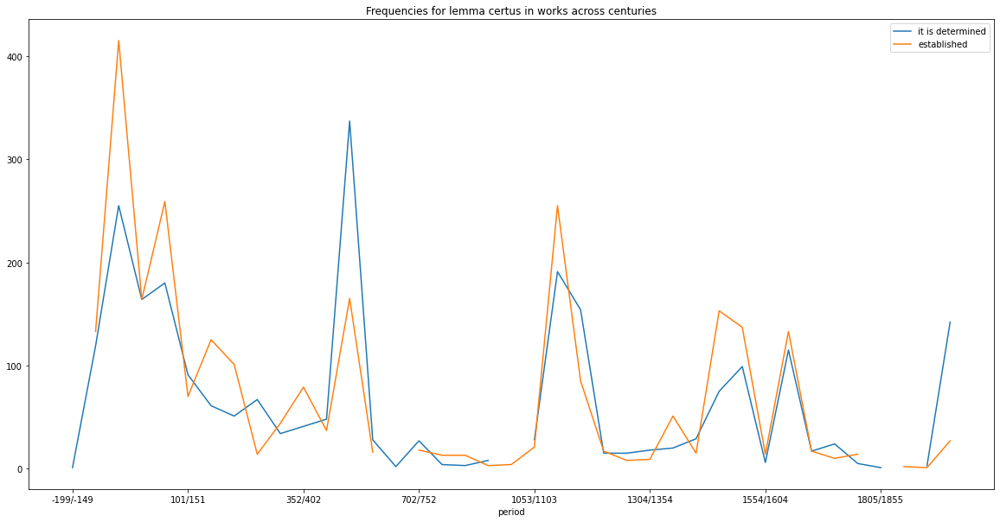

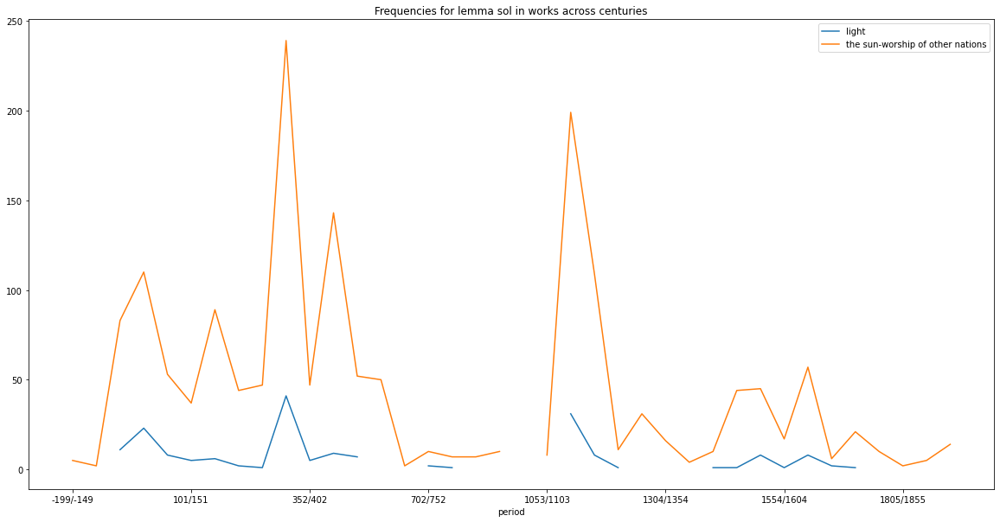

...

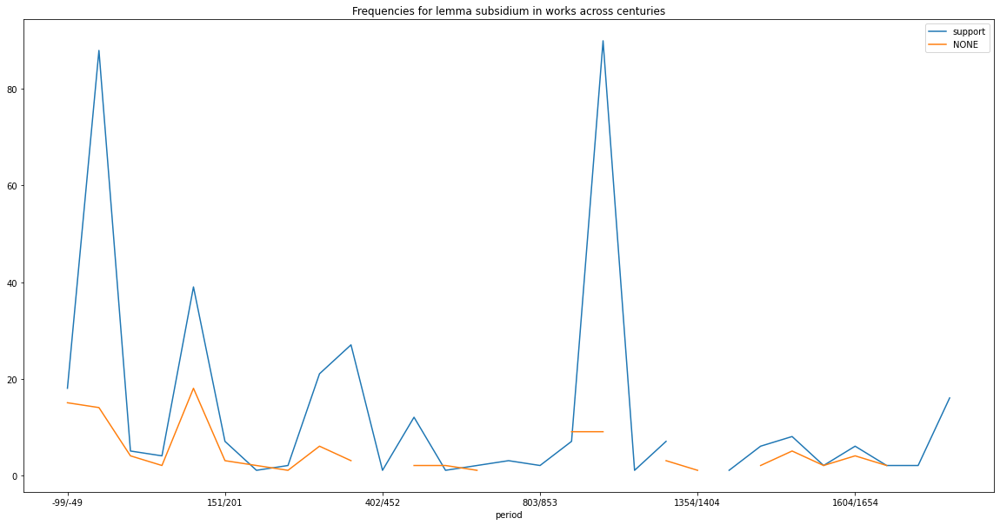

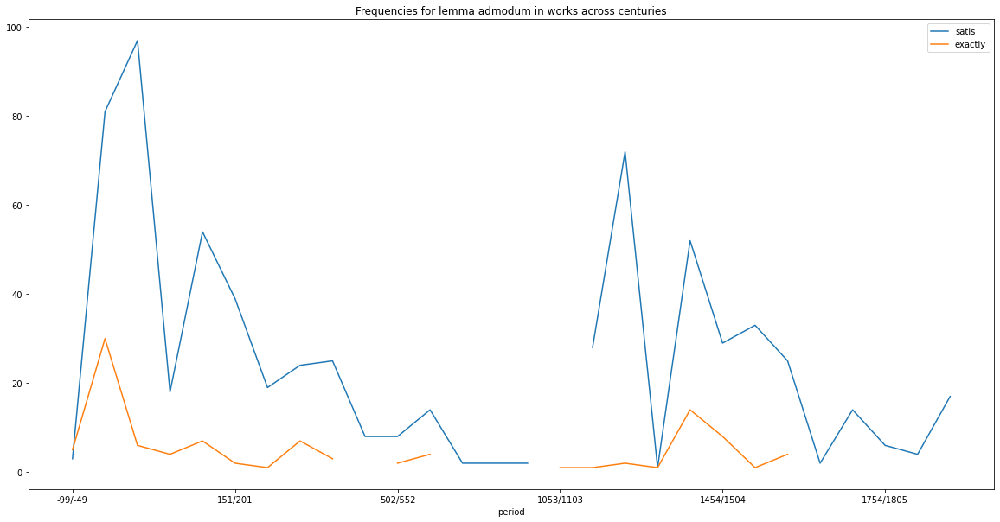

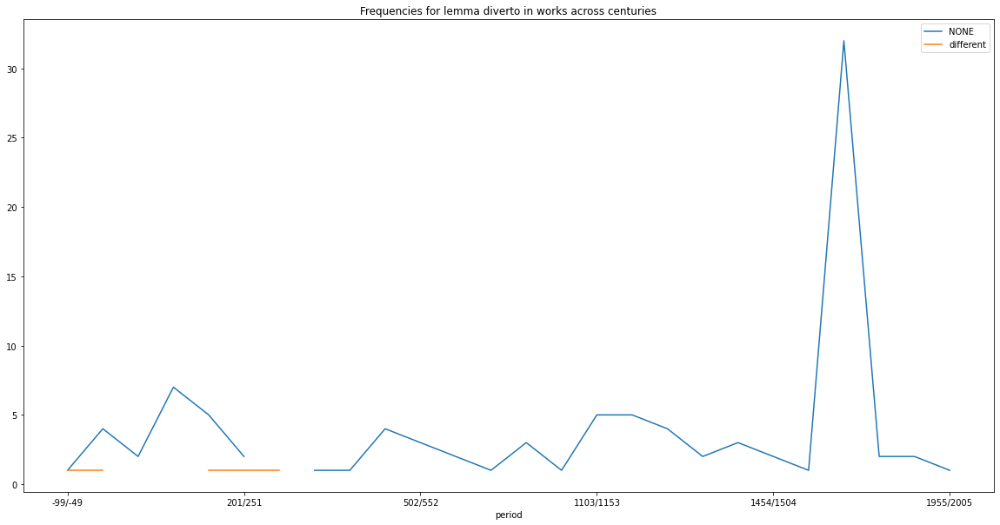

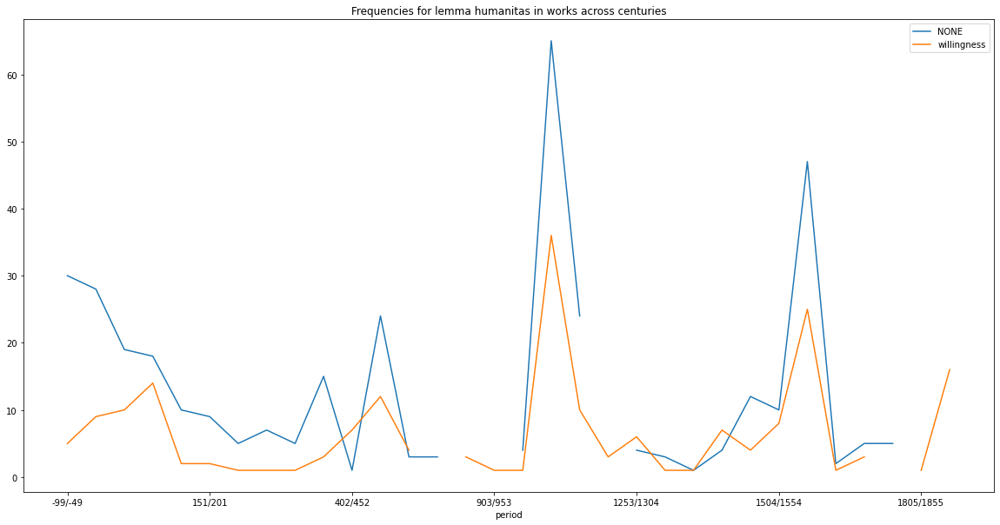

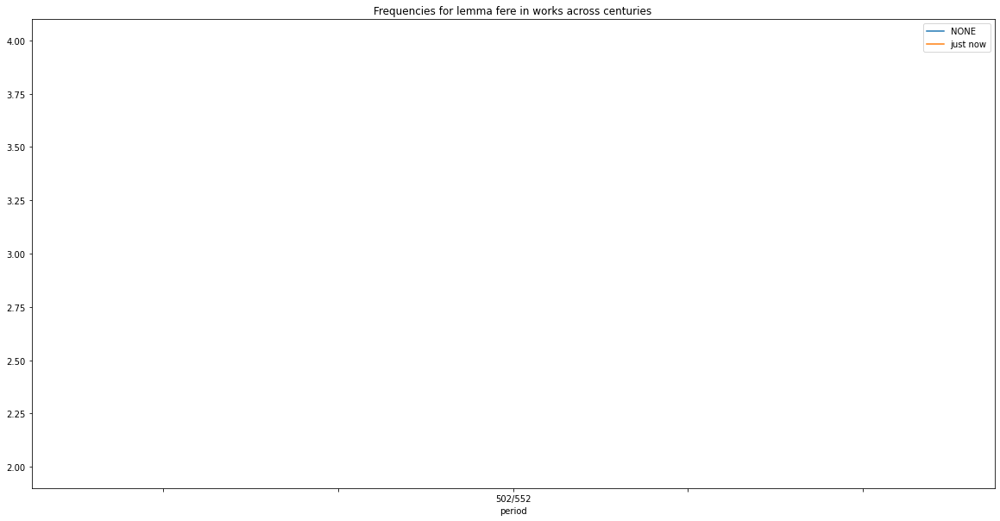

In [ ]:
root = "figures"

add_senses_in_legend = True

for lemma in latinise.lemma.unique():
  latinise.dropna()[latinise.lemma==lemma].sort_values("date").groupby(["period", "sense"], sort=False).size().unstack().plot(figsize=(20, 10))
  plt.title(f"Frequencies for lemma {lemma} in works across centuries")
  if add_senses_in_legend:
    legend = []
    for x in latinise.dropna()[latinise.lemma==lemma].groupby(["sense"])["sense_filtered"].last():
      legend.append(x.split(" ; ")[0])
    plt.legend(legend)
    plt.savefig(os.path.join(root, f"{lemma}_with_senses.png"))
  else:
    plt.savefig(os.path.join(root, f"{lemma}.png"))

## Visualisation of prose vs poetry

### Individual lemmas

<ipython-input-145-b8e701da2bc5>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  latinise.dropna()[(latinise.lemma==lemma)&(latinise.type=="prose")].sort_values("date").groupby(["period", "sense"], sort=False).size().unstack().plot(figsize=(20, 10), ax=axes[0])
<ipython-input-145-b8e701da2bc5>:15: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  latinise.dropna()[(latinise.lemma==lemma)&(latinise.type!="prose")].sort_values("date").groupby(["period", "sense"], sort=False).size().unstack().plot(figsize=(20, 10), ax=axes[1])
<ipython-input-145-b8e701da2bc5>:21: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  for x in latinise.dropna()[latinise.lemma==lemma].groupby(["sense"])["sense_filtered"].last():
<ipython-input-145-b8e701da2bc5>:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  latinise.dropna()[(latinise.lemma==lemma)&(latinise.type=="prose")].sort_values("da

TypeError: ignored

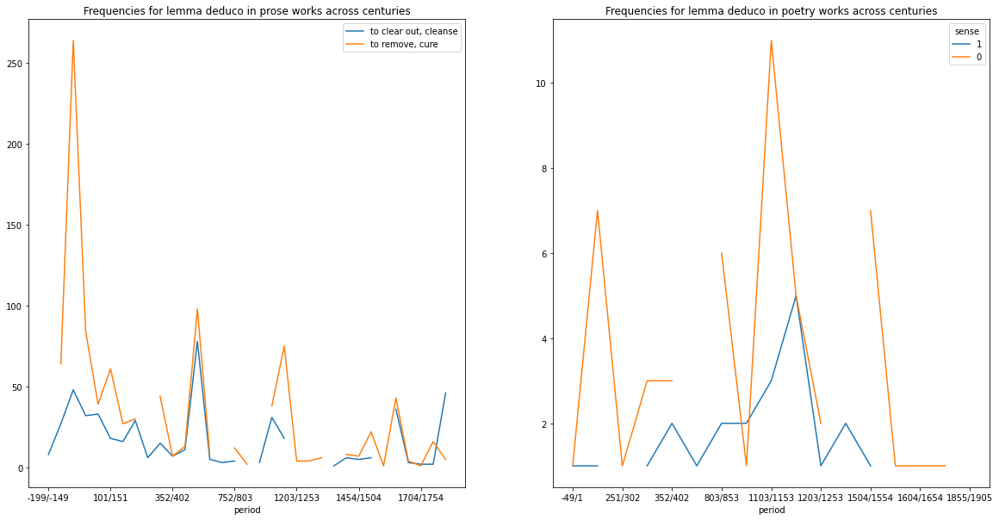

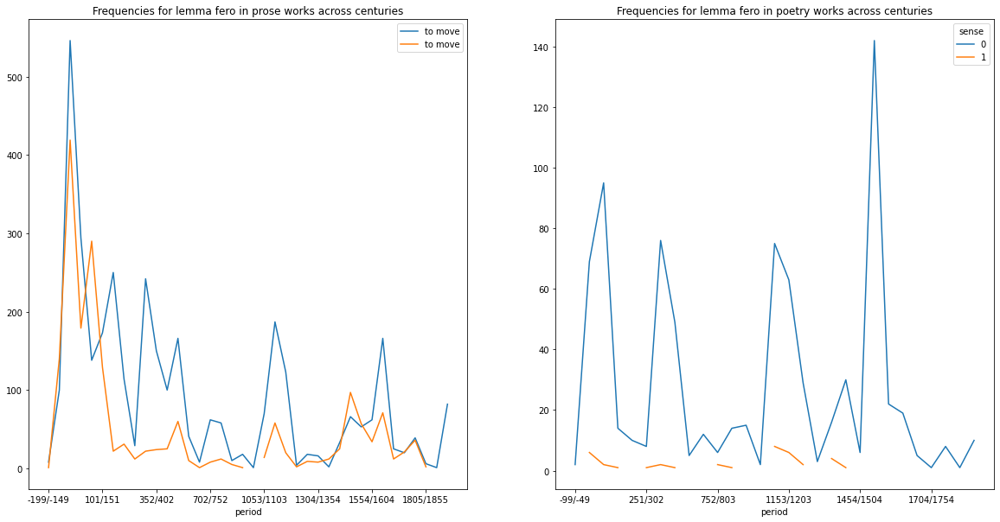

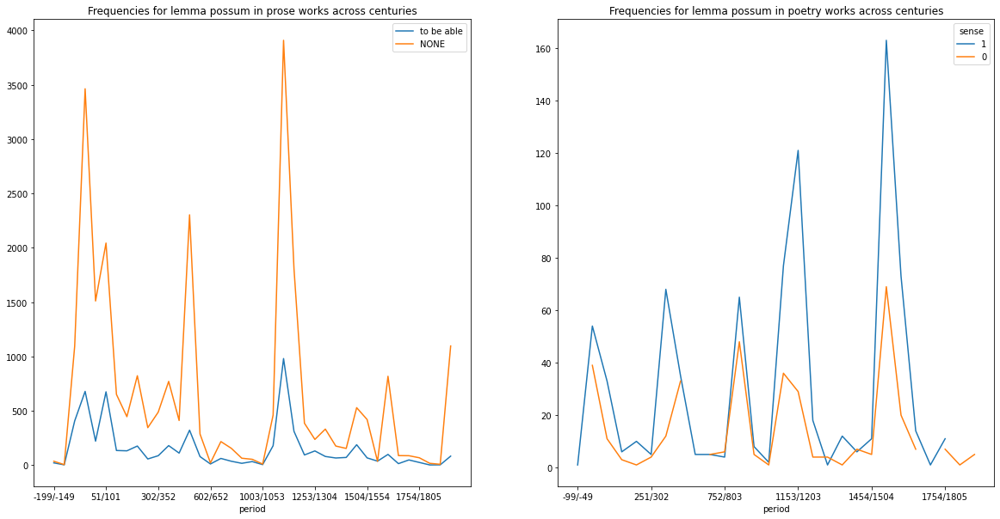

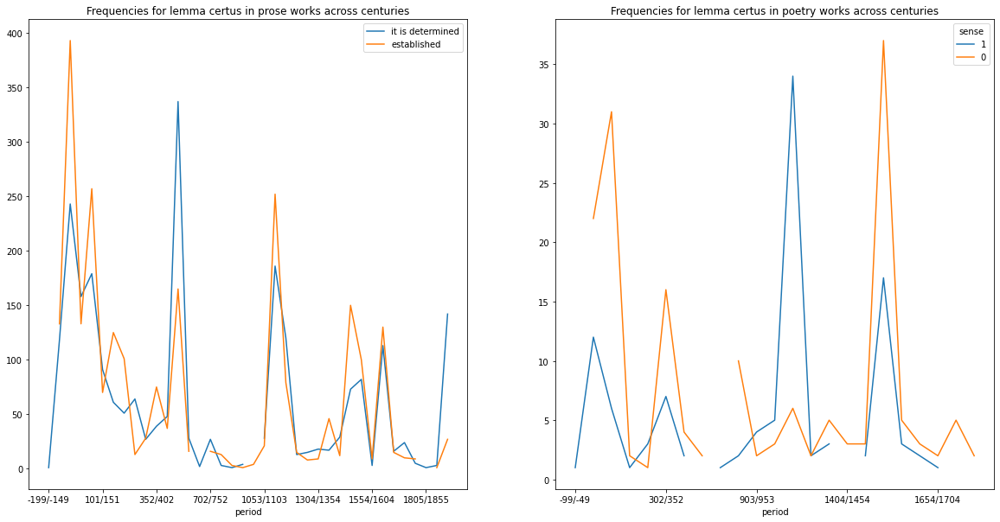

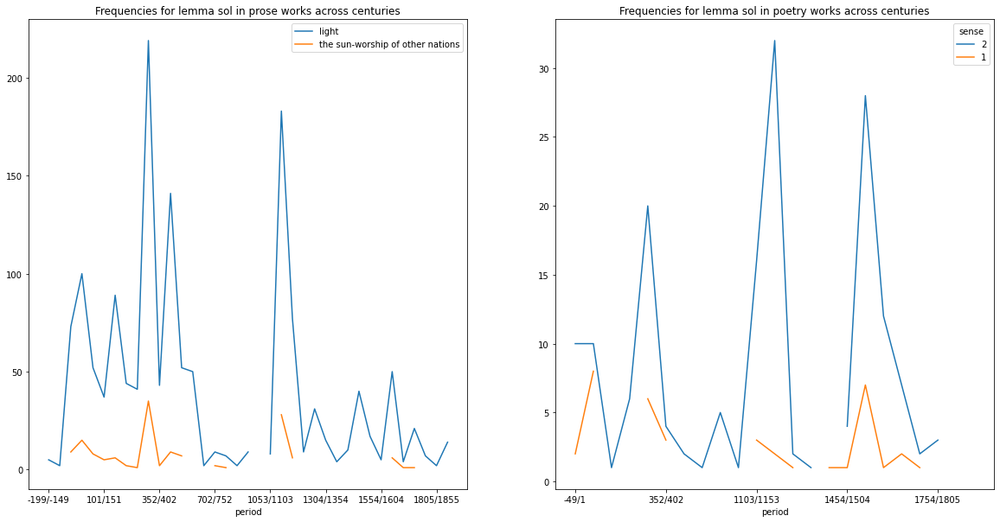

...

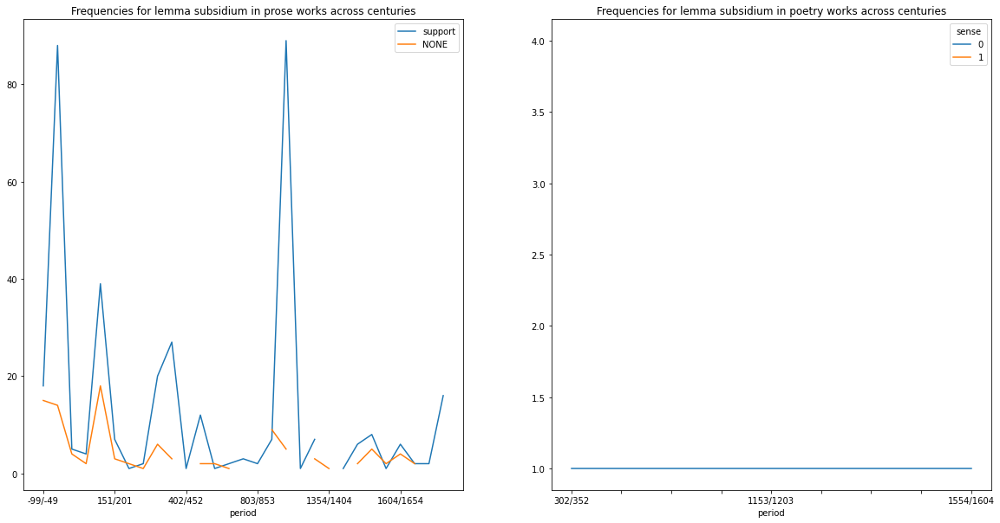

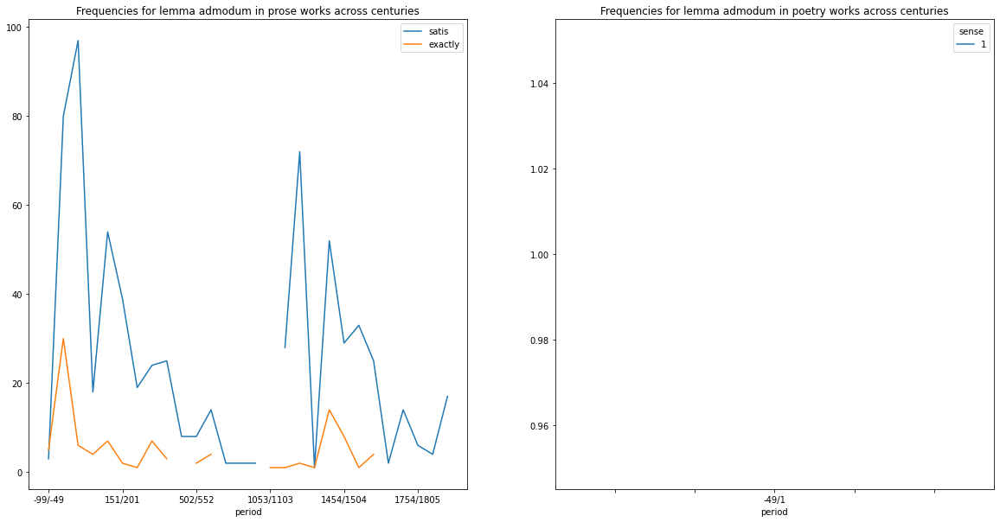

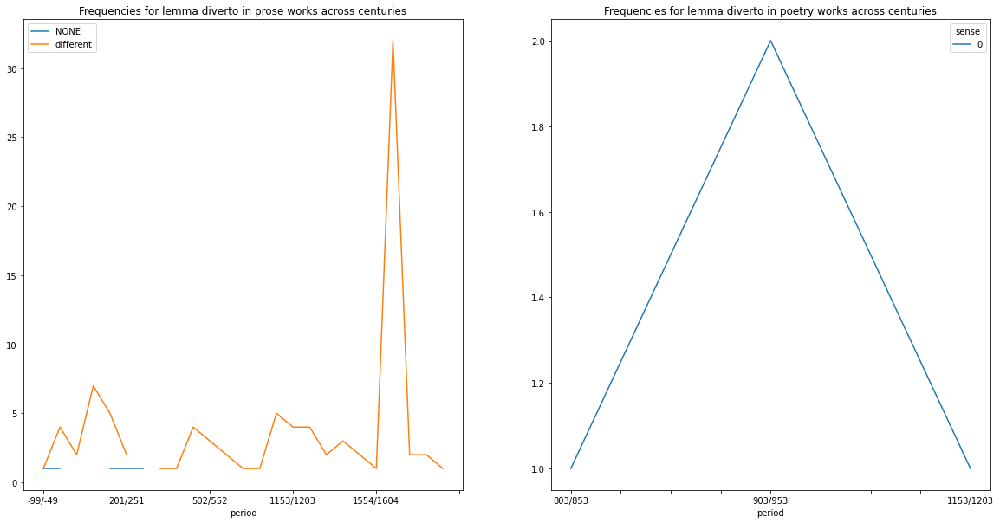

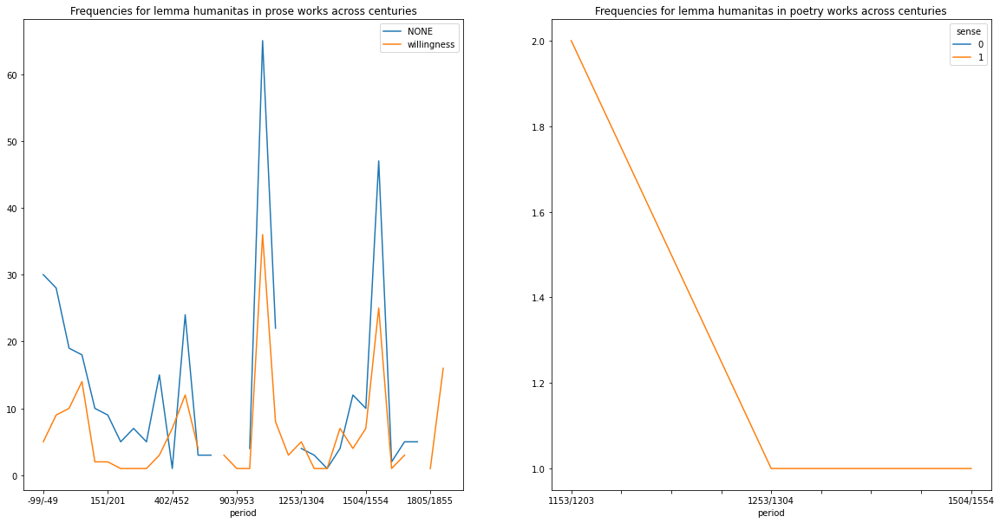

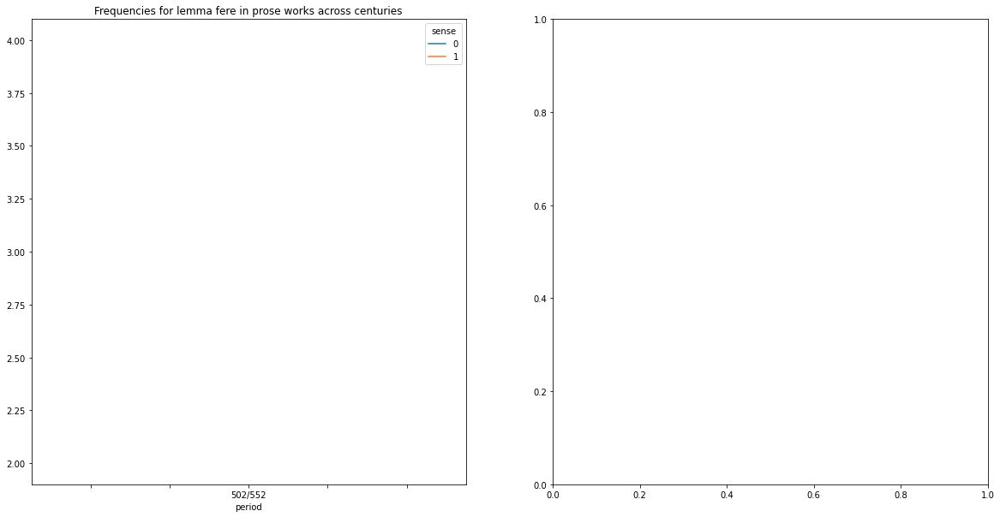

In [ ]:
import matplotlib.pyplot as plt
import os

root = "figures_prose_poetry"

add_senses_in_legend = True

for lemma in latinise.lemma.unique():
  fig, axes = plt.subplots(ncols=2)

  latinise.dropna()[(latinise.lemma==lemma)&(latinise.type=="prose")].sort_values("date").groupby(["period", "sense"], sort=False).size().unstack().plot(figsize=(20, 10), ax=axes[0])

  axes[0].set_title(f"Frequencies for lemma {lemma} in prose works across centuries")

  latinise.dropna()[(latinise.lemma==lemma)&(latinise.type!="prose")].sort_values("date").groupby(["period", "sense"], sort=False).size().unstack().plot(figsize=(20, 10), ax=axes[1])

  axes[1].set_title(f"Frequencies for lemma {lemma} in poetry works across centuries")

  if add_senses_in_legend:
    legend = []
    for x in latinise.dropna()[latinise.lemma==lemma].groupby(["sense"])["sense_filtered"].last():
      legend.append(x.split(" ; ")[0])
    
    axes[0].legend(legend)
    axes[0].legend(legend)

    plt.savefig(os.path.join(root, f"{lemma}_with_senses.png"))
  else:
    plt.savefig(os.path.join(root, f"{lemma}.png"))

In [ ]:
latinise[(latinise.lemma=="diverto")&(latinise.type=="prose")&(latinise.sense==0)]["sentence"][:10]

483982                qui licuit igitur ab illa divertere  
483984           illuc amabat regina divertere curis fessa 
483988    quantillo momento se fortuna in diversissimas ...
483989           peius ab sua argenide quam a me divertet  
483990    habens iter tridui , si in funem insulam diver...
483991    ne divertant ad compotationes , aut alia nequi...
483992       ego divertebam , eodem mecum vehiculo perduco 
483993    inquies , externae gentis homo divertis ad per...
483995    felicitatis , inquit , cupiditas , quam vos qu...
483996    audiebat extinctum poliarchum , a quo eius spe...
Name: sentence, dtype: object

In [ ]:
latinise[(latinise.lemma=="diverto")&(latinise.type=="prose")&(latinise.sense==1)]["sentence"][:10]

483983     diversissima erunt , quae illi praefecto lega...
483985     diversissimis indigent ad suas actiones perag...
483986    optimatum potestate , quae utique diversissima...
483987    animos quaesitorum diversissima ambage impediunt 
483994    eligitur sacer lucus , in quo conseptant anima...
483998    tam dispar diversissimorum deorum disciplina e...
484003    prima norma est humani spiritus universalitas ...
484004    error etiam linguae divertentis a genio graeci...
484023    et ut partes librorum inter se variae , ita et...
484041    nam et quae diversissimorum temporum sunt , co...
Name: sentence, dtype: object